In [1]:
import os
import numpy as np
from PIL import Image
from scipy import ndimage
import cv2
import torch
from test_utils import psnr, psnr_transform
from pytorch_msssim import ms_ssim
from annotator.util import resize_image, HWC3
from annotator.uniformer import UniformerDetector
import matplotlib.pyplot as plt

# Updated post_process function
def post_process(predicted_image, mask):
    predicted_image_np = np.array(predicted_image)

    # Ensure mask is in the correct format (8-bit single-channel)
    if len(mask.shape) == 3:
        mask = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY)
    if mask.dtype != np.uint8:
        mask = (mask * 255).astype(np.uint8)

    # Inpainting
    inpainted_image = cv2.inpaint(predicted_image_np, mask, 3, cv2.INPAINT_TELEA)

    # Contrast adjustment
    contrast_image = cv2.convertScaleAbs(predicted_image_np, alpha=1.5, beta=0)

    # Morphological transformation
    kernel = np.ones((5, 5), np.uint8)
    morph_image = cv2.morphologyEx(predicted_image_np, cv2.MORPH_CLOSE, kernel)

    # Denoising
    denoised_image = cv2.fastNlMeansDenoisingColored(predicted_image_np, None, 10, 10, 7, 21)

    # Return processed images in a dictionary
    return {
        'inpaint': Image.fromarray(inpainted_image),
        'contrast': Image.fromarray(contrast_image),
        'morph': Image.fromarray(morph_image),
        'denoise': Image.fromarray(denoised_image)
    }

/data/maryam.sana/anaconda3/envs/unicontrol/lib/python3.8/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: libtorch_cuda_cu.so: cannot open shared object file: No such file or directory
  warn(f"Failed to load image Python extension: {e}")


In [2]:
apply_seg = UniformerDetector()

def get_mask(seg_image):
    seg_detected_map, _ = apply_seg(HWC3(seg_image))
    return HWC3(seg_detected_map)

Use Checkpoint: False
Checkpoint Number: [0, 0, 0, 0]
Use global window for all blocks in stage3
load checkpoint from local path: /data/maryam.sana/Uni-ControlNet/annotator/ckpts/upernet_global_small.pth


In [6]:
def plot_and_save_images(test_image, pred_image, post_processed_images, output_dir, base_filename):
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    axes = axes.flatten()

    axes[0].imshow(test_image)
    axes[0].set_title("Ground Truth")
    axes[0].axis('off')

    axes[1].imshow(pred_image)
    axes[1].set_title("Predicted Image")
    axes[1].axis('off')

    for ax, (key, img) in zip(axes[2:], post_processed_images.items()):
        ax.imshow(img)
        ax.set_title(f"Post-Processed: {key}")
        ax.axis('off')

    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{base_filename}_results.png"))
    plt.show()


In [4]:
# Directories
preds_dir = "data/preds/finetuned_local_uni_v15/"
test_images_dir = "data/test_data/"

# Collect predicted image filenames
pred_filenames = sorted(os.listdir(preds_dir))
test_filenames = sorted(os.listdir(test_images_dir))

# Store results
results = []
output_dir = "output_results"

j_017
sizes (896, 512) (896, 512)
Image: j_017
Initial PSNR: 15.932426452636719, Initial MS-SSIM: 0.5554167032241821
Post-Processed inpaint: PSNR: 15.932426452636719, MS-SSIM: 0.5554167032241821
Post-Processed contrast: PSNR: 11.05853271484375, MS-SSIM: 0.4960298240184784
Post-Processed morph: PSNR: 15.837905883789062, MS-SSIM: 0.5660075545310974
Post-Processed denoise: PSNR: 16.099891662597656, MS-SSIM: 0.5823637843132019


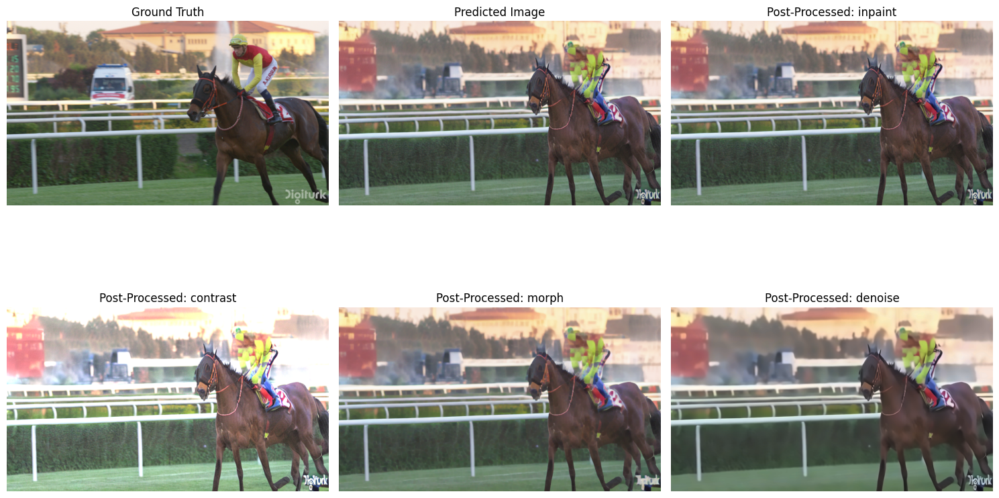

j_017
sizes (896, 512) (896, 512)
Image: j_017
Initial PSNR: 11.960273742675781, Initial MS-SSIM: 0.41662588715553284
Post-Processed inpaint: PSNR: 11.960273742675781, MS-SSIM: 0.41662588715553284
Post-Processed contrast: PSNR: 9.281970977783203, MS-SSIM: 0.38581570982933044
Post-Processed morph: PSNR: 11.932849884033203, MS-SSIM: 0.4234842360019684
Post-Processed denoise: PSNR: 12.024452209472656, MS-SSIM: 0.43431174755096436


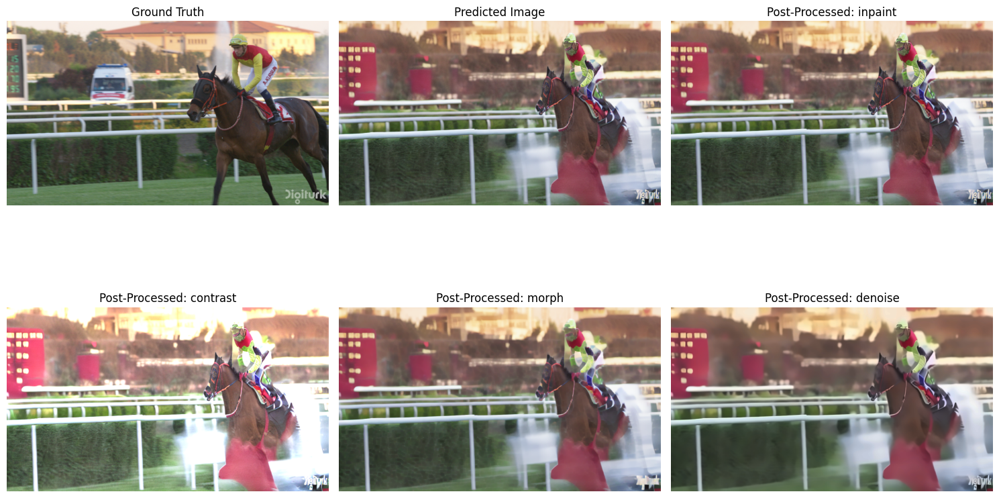

j_017
sizes (896, 512) (896, 512)
Image: j_017
Initial PSNR: 15.988933563232422, Initial MS-SSIM: 0.5663118362426758
Post-Processed inpaint: PSNR: 15.988933563232422, MS-SSIM: 0.5663118362426758
Post-Processed contrast: PSNR: 11.210628509521484, MS-SSIM: 0.5109434723854065
Post-Processed morph: PSNR: 15.867927551269531, MS-SSIM: 0.5751686096191406
Post-Processed denoise: PSNR: 16.1297607421875, MS-SSIM: 0.5873191356658936


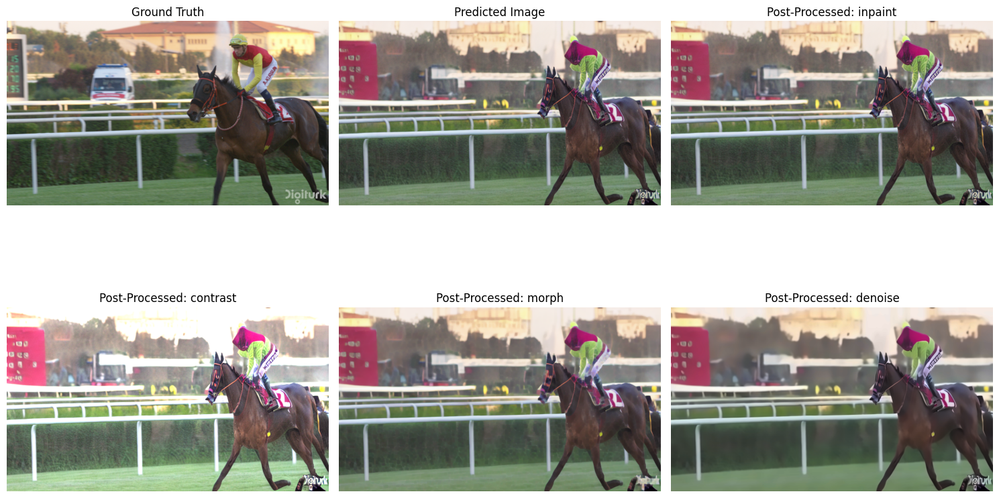

j_017
sizes (896, 512) (896, 512)
Image: j_017
Initial PSNR: 14.743705749511719, Initial MS-SSIM: 0.46928870677948
Post-Processed inpaint: PSNR: 14.743705749511719, MS-SSIM: 0.46928870677948
Post-Processed contrast: PSNR: 10.122161865234375, MS-SSIM: 0.4083269536495209
Post-Processed morph: PSNR: 14.528579711914062, MS-SSIM: 0.48540472984313965
Post-Processed denoise: PSNR: 14.975078582763672, MS-SSIM: 0.5082753300666809


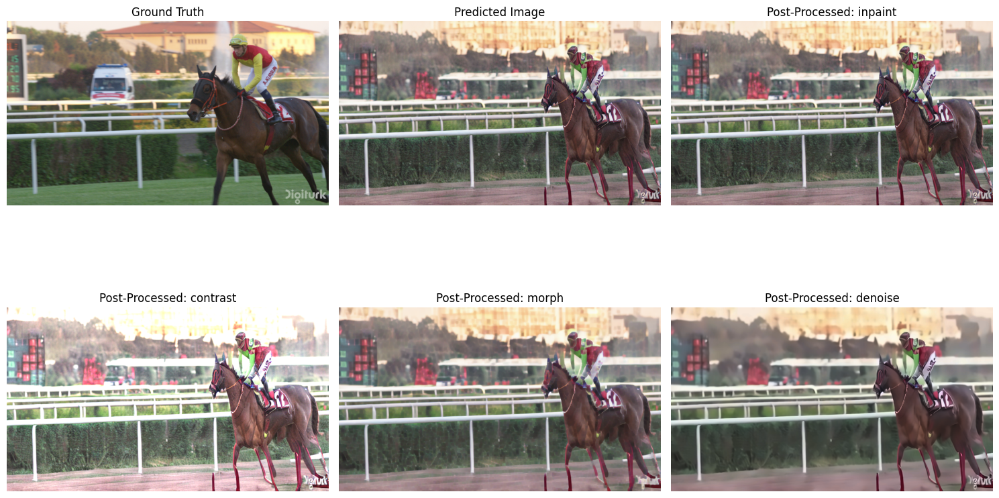

r_002
sizes (896, 512) (896, 512)
Image: r_002
Initial PSNR: 14.041679382324219, Initial MS-SSIM: 0.43481123447418213
Post-Processed inpaint: PSNR: 14.041679382324219, MS-SSIM: 0.43481123447418213
Post-Processed contrast: PSNR: 10.838733673095703, MS-SSIM: 0.40481260418891907
Post-Processed morph: PSNR: 13.499919891357422, MS-SSIM: 0.43680787086486816
Post-Processed denoise: PSNR: 14.214462280273438, MS-SSIM: 0.4416181743144989


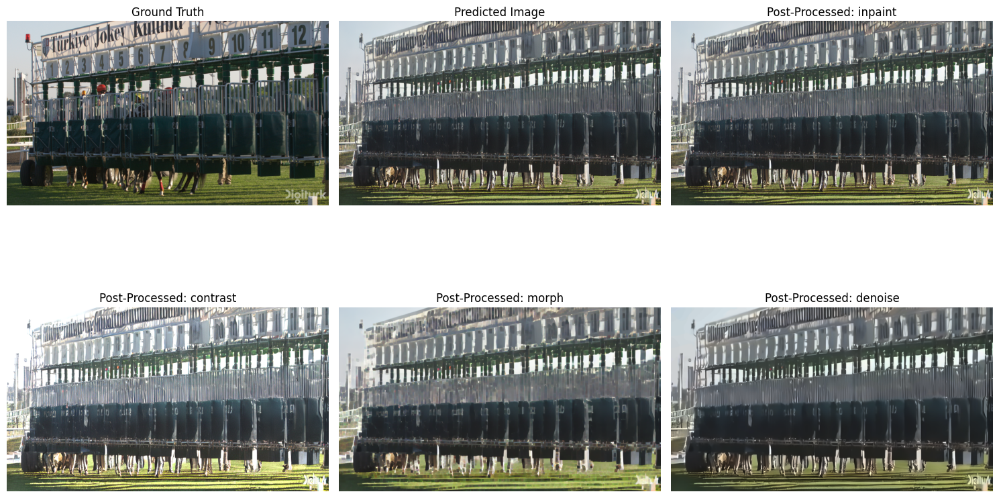

r_002
sizes (896, 512) (896, 512)
Image: r_002
Initial PSNR: 13.449169158935547, Initial MS-SSIM: 0.4121725559234619
Post-Processed inpaint: PSNR: 13.449169158935547, MS-SSIM: 0.4121725559234619
Post-Processed contrast: PSNR: 11.198783874511719, MS-SSIM: 0.37934112548828125
Post-Processed morph: PSNR: 13.166191101074219, MS-SSIM: 0.40779629349708557
Post-Processed denoise: PSNR: 13.558479309082031, MS-SSIM: 0.41718387603759766


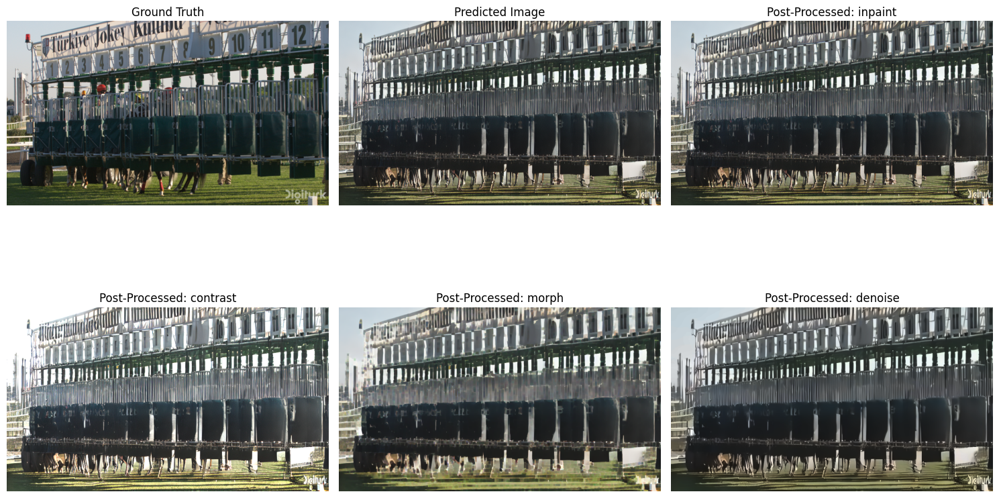

r_002
sizes (896, 512) (896, 512)
Image: r_002
Initial PSNR: 13.984458923339844, Initial MS-SSIM: 0.44781801104545593
Post-Processed inpaint: PSNR: 13.984458923339844, MS-SSIM: 0.44781801104545593
Post-Processed contrast: PSNR: 11.244178771972656, MS-SSIM: 0.4151473939418793
Post-Processed morph: PSNR: 13.643081665039062, MS-SSIM: 0.45303258299827576
Post-Processed denoise: PSNR: 14.113792419433594, MS-SSIM: 0.4548276960849762


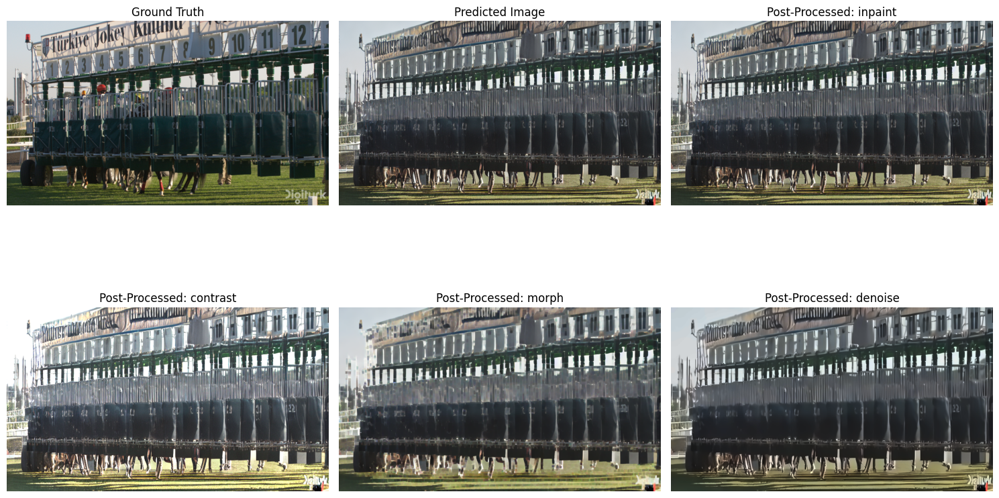

r_002
sizes (896, 512) (896, 512)
Image: r_002
Initial PSNR: 11.904991149902344, Initial MS-SSIM: 0.35785651206970215
Post-Processed inpaint: PSNR: 11.904991149902344, MS-SSIM: 0.35785651206970215
Post-Processed contrast: PSNR: 9.687957763671875, MS-SSIM: 0.332258939743042
Post-Processed morph: PSNR: 11.52932357788086, MS-SSIM: 0.3593883514404297
Post-Processed denoise: PSNR: 11.989517211914062, MS-SSIM: 0.3670227527618408


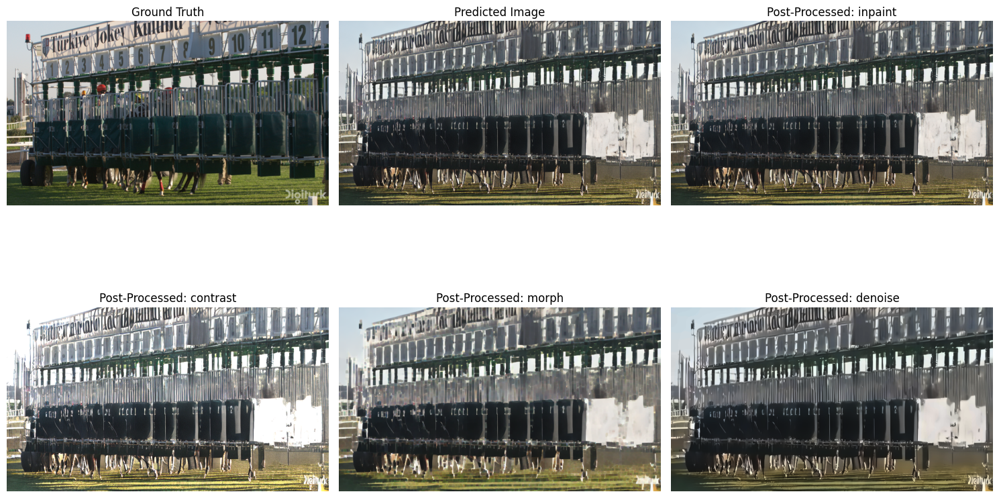

s_003
sizes (896, 512) (896, 512)
Image: s_003
Initial PSNR: 14.392757415771484, Initial MS-SSIM: 0.1989593505859375
Post-Processed inpaint: PSNR: 14.392757415771484, MS-SSIM: 0.1989593505859375
Post-Processed contrast: PSNR: 11.214588165283203, MS-SSIM: 0.15113627910614014
Post-Processed morph: PSNR: 14.586780548095703, MS-SSIM: 0.22433006763458252
Post-Processed denoise: PSNR: 14.711780548095703, MS-SSIM: 0.20598168671131134


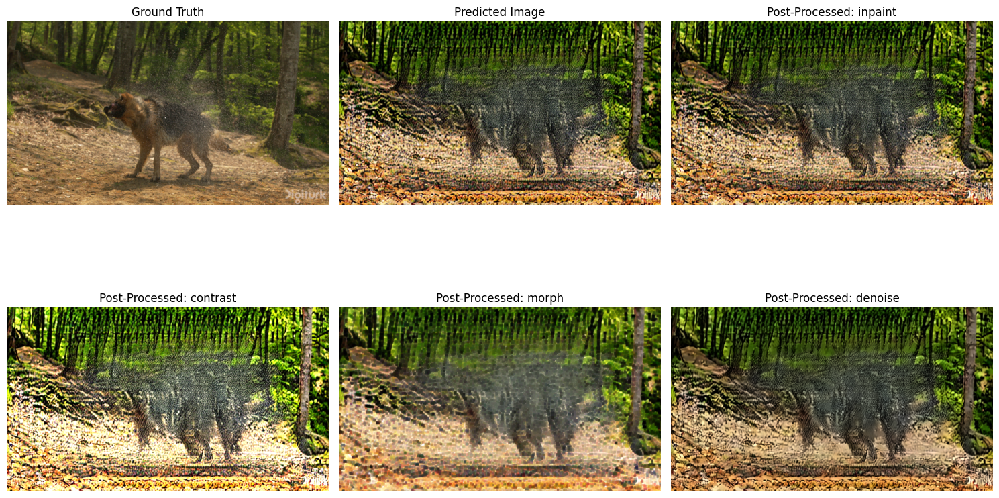

s_003
sizes (896, 512) (896, 512)
Image: s_003
Initial PSNR: 14.542465209960938, Initial MS-SSIM: 0.21271033585071564
Post-Processed inpaint: PSNR: 14.542465209960938, MS-SSIM: 0.21271033585071564
Post-Processed contrast: PSNR: 11.744144439697266, MS-SSIM: 0.16421270370483398
Post-Processed morph: PSNR: 14.898311614990234, MS-SSIM: 0.23062537610530853
Post-Processed denoise: PSNR: 14.865509033203125, MS-SSIM: 0.2222018837928772


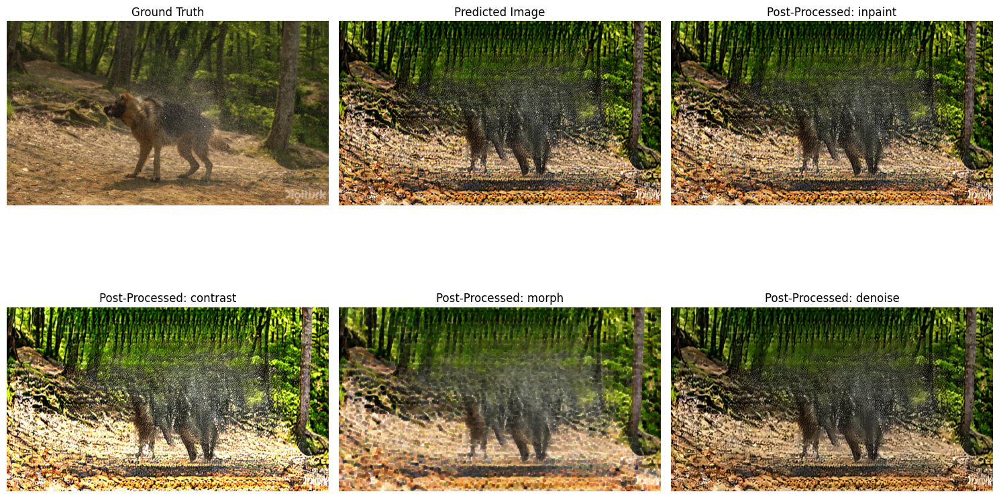

s_003
sizes (896, 512) (896, 512)
Image: s_003
Initial PSNR: 14.16568374633789, Initial MS-SSIM: 0.19480061531066895
Post-Processed inpaint: PSNR: 14.16568374633789, MS-SSIM: 0.19480061531066895
Post-Processed contrast: PSNR: 11.239681243896484, MS-SSIM: 0.14834176003932953
Post-Processed morph: PSNR: 14.1365966796875, MS-SSIM: 0.21079348027706146
Post-Processed denoise: PSNR: 14.4892578125, MS-SSIM: 0.2046859711408615


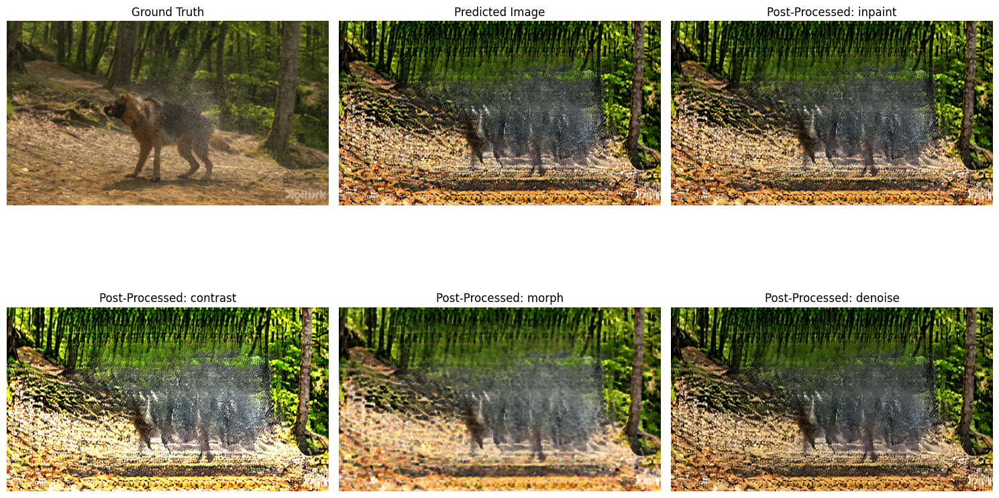

s_003
sizes (896, 512) (896, 512)
Image: s_003
Initial PSNR: 14.804706573486328, Initial MS-SSIM: 0.2036256343126297
Post-Processed inpaint: PSNR: 14.804706573486328, MS-SSIM: 0.2036256343126297
Post-Processed contrast: PSNR: 11.733501434326172, MS-SSIM: 0.15479445457458496
Post-Processed morph: PSNR: 14.963371276855469, MS-SSIM: 0.2195541113615036
Post-Processed denoise: PSNR: 15.1436767578125, MS-SSIM: 0.21303172409534454


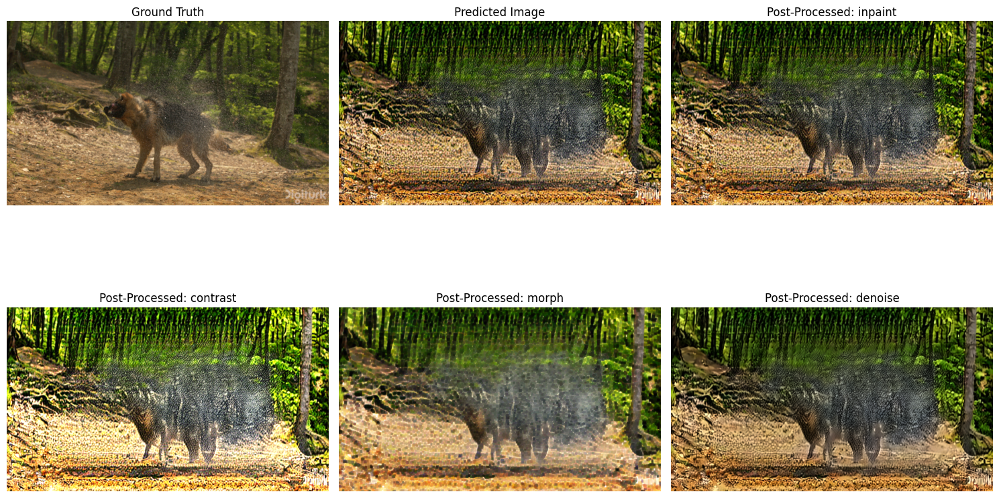

y_007
sizes (896, 512) (896, 512)
Image: y_007
Initial PSNR: 11.326103210449219, Initial MS-SSIM: 0.46120426058769226
Post-Processed inpaint: PSNR: 11.326103210449219, MS-SSIM: 0.46120426058769226
Post-Processed contrast: PSNR: 8.535167694091797, MS-SSIM: 0.4528803825378418
Post-Processed morph: PSNR: 10.791297912597656, MS-SSIM: 0.4737933874130249
Post-Processed denoise: PSNR: 11.403411865234375, MS-SSIM: 0.4946945607662201


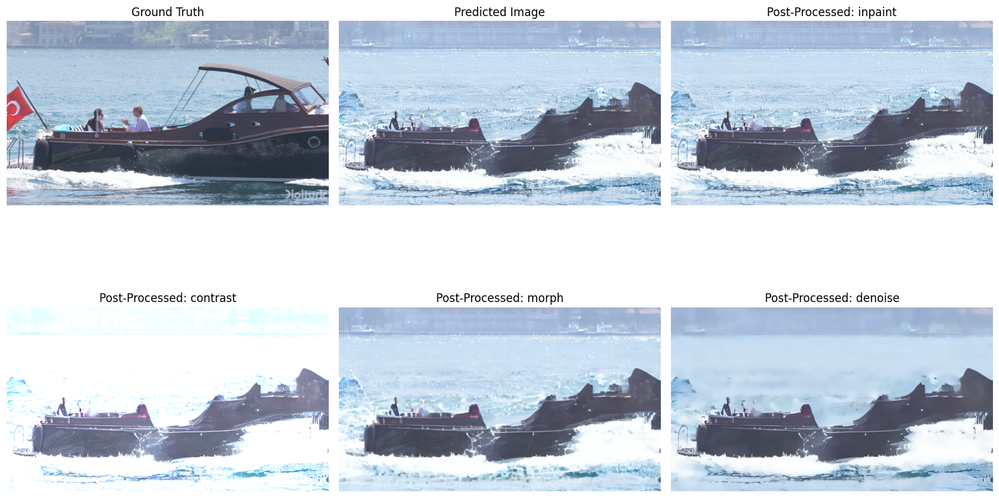

y_007
sizes (896, 512) (896, 512)
Image: y_007
Initial PSNR: 11.069026947021484, Initial MS-SSIM: 0.4169749319553375
Post-Processed inpaint: PSNR: 11.069026947021484, MS-SSIM: 0.4169749319553375
Post-Processed contrast: PSNR: 7.870380401611328, MS-SSIM: 0.42876410484313965
Post-Processed morph: PSNR: 10.502613067626953, MS-SSIM: 0.4385409355163574
Post-Processed denoise: PSNR: 11.16128158569336, MS-SSIM: 0.47101619839668274


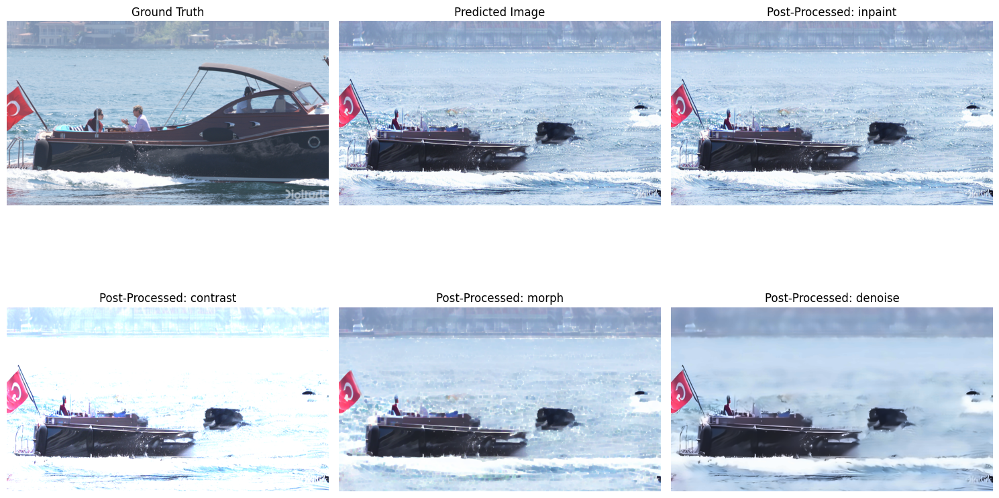

y_007
sizes (896, 512) (896, 512)
Image: y_007
Initial PSNR: 13.425167083740234, Initial MS-SSIM: 0.4877258241176605
Post-Processed inpaint: PSNR: 13.425167083740234, MS-SSIM: 0.4877258241176605
Post-Processed contrast: PSNR: 9.261787414550781, MS-SSIM: 0.44455766677856445
Post-Processed morph: PSNR: 12.90066146850586, MS-SSIM: 0.4945645034313202
Post-Processed denoise: PSNR: 13.551139831542969, MS-SSIM: 0.5167683959007263


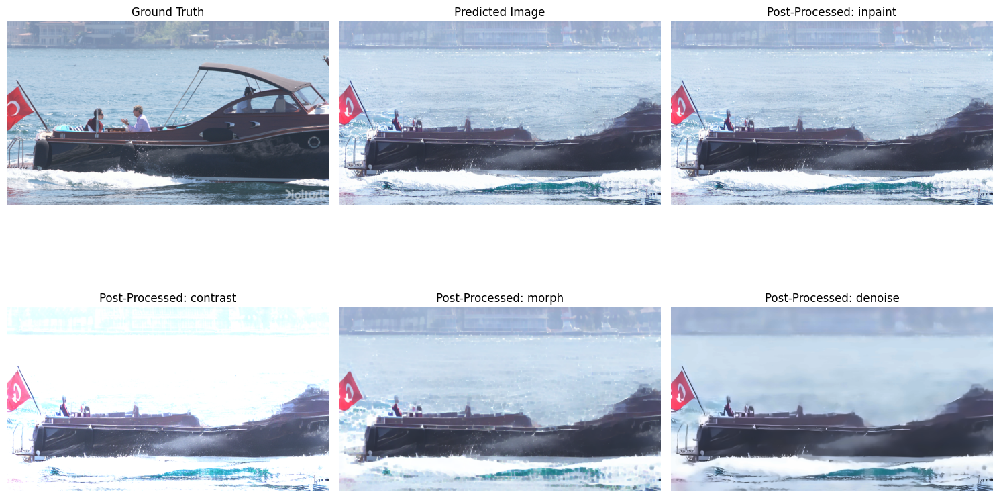

y_007
sizes (896, 512) (896, 512)
Image: y_007
Initial PSNR: 10.071983337402344, Initial MS-SSIM: 0.3528662919998169
Post-Processed inpaint: PSNR: 10.071983337402344, MS-SSIM: 0.3528662919998169
Post-Processed contrast: PSNR: 7.666126251220703, MS-SSIM: 0.4093644618988037
Post-Processed morph: PSNR: 9.503639221191406, MS-SSIM: 0.376766175031662
Post-Processed denoise: PSNR: 10.145458221435547, MS-SSIM: 0.413552850484848


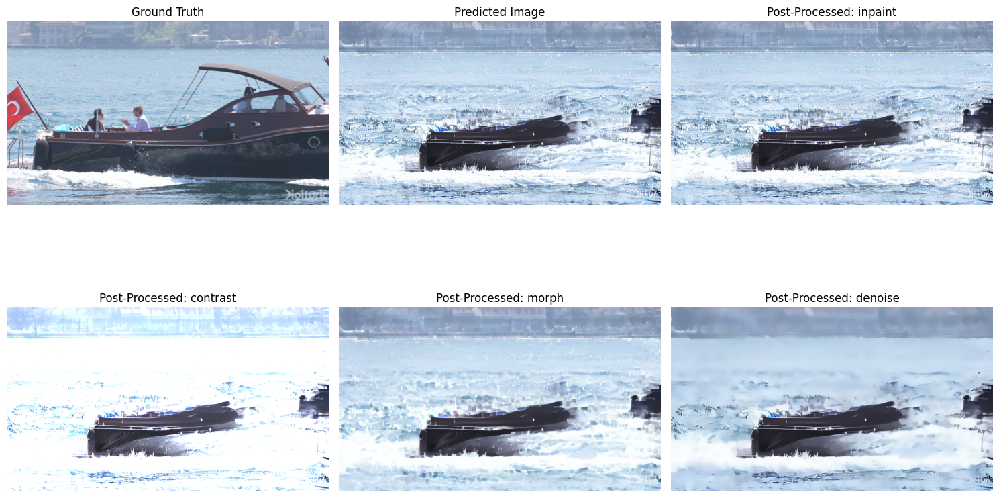

TypeError: Object of type Tensor is not JSON serializable

In [7]:
for pred_filename in pred_filenames:
    pred_path = os.path.join(preds_dir, pred_filename)
    base_filename = '_'.join(pred_filename.split('_')[:2])  # Extract base name correctly
    print(base_filename)  # Output: j_017
    test_path = os.path.join(test_images_dir, f"{base_filename}.png")  # Assuming .png extension for ground truth images

    if not os.path.exists(test_path):
        print(test_path)
        print(f"Ground truth image not found for {pred_filename}")
        continue

    # Load images
    pred_image = Image.open(pred_path).convert("RGB")
    test_image = Image.open(test_path).convert("RGB")
    
    # Resize test image to match predicted image size
    test_image = test_image.resize(pred_image.size)

    mask = get_mask(np.array(test_image))  # Assuming get_mask is a function that generates the mask
    print('sizes', pred_image.size, test_image.size)
    
    # Convert images to tensors
    ref_tensor = psnr_transform(test_image)
    pred_tensor = psnr_transform(pred_image)

    # Calculate initial metrics
    psnr_initial = psnr(ref_tensor, pred_tensor)
    ms_ssim_initial = ms_ssim(ref_tensor.unsqueeze(0), pred_tensor.unsqueeze(0), data_range=255, size_average=True).item()

    # Apply post-processing
    post_processed_images = post_process(pred_image, mask)

    # Calculate metrics for post-processed images
    post_process_metrics = {}
    for key, pp_image in post_processed_images.items():
        pp_tensor = psnr_transform(pp_image)
        psnr_pp = psnr(ref_tensor, pp_tensor)
        ms_ssim_pp = ms_ssim(ref_tensor.unsqueeze(0), pp_tensor.unsqueeze(0), data_range=255, size_average=True).item()
        post_process_metrics[key] = (psnr_pp, ms_ssim_pp)
    
    # Store result
    results.append({
        "image": base_filename,
        "psnr_initial": psnr_initial,
        "ms_ssim_initial": ms_ssim_initial,
        "post_process_metrics": post_process_metrics
    })

    # Print results
    print(f"Image: {base_filename}")
    print(f"Initial PSNR: {psnr_initial}, Initial MS-SSIM: {ms_ssim_initial}")
    for key, (psnr_pp, ms_ssim_pp) in post_process_metrics.items():
        print(f"Post-Processed {key}: PSNR: {psnr_pp}, MS-SSIM: {ms_ssim_pp}")

    # Plot and save images
    plot_and_save_images(test_image, pred_image, post_processed_images, output_dir, base_filename)

# Optional: Save results to a file (e.g., CSV or JSON)
import json
with open("results.json", "w") as f:
    json.dump(results, f, indent=4)